In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from random import randrange,uniform
from sklearn.metrics import r2_score
from scipy import stats

In [2]:
import matplotlib.pyplot as plt
plt.style.use('classic')
%matplotlib inline

In [3]:
!pip install klib

  Using cached seaborn-0.11.2-py3-none-any.whl (292 kB)
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.11.0
    Uninstalling seaborn-0.11.0:
      Successfully uninstalled seaborn-0.11.0


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bamboolib 1.26.0 requires seaborn<0.11,>=0.10, but you have seaborn 0.11.2 which is incompatible.


In [4]:
!pip install delayed

In [5]:
os.getcwd()

'C:\\Users\\Admin\\Documents'

In [6]:
#from google.colab import drive
#drive.mount('/content/gdrive', force_remount=True)

In [7]:
import pandas as pd
Data_Day = pd.read_csv(r'C:\\Users\\Admin\\Documents/temperature.csv')
Data_Day

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [8]:
Data_Day['Date'] = pd.to_datetime(Data_Day.Date)
Data_Day['Date'] = Data_Day['Date'].dt.strftime('%Y-%m-%d')
Data_Day

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [9]:
Data_Day.nunique()

station               25
Date                 310
Present_Tmax         167
Present_Tmin         155
LDAPS_RHmin         7672
LDAPS_RHmax         7664
LDAPS_Tmax_lapse    7675
LDAPS_Tmin_lapse    7675
LDAPS_WS            7675
LDAPS_LH            7675
LDAPS_CC1           7569
LDAPS_CC2           7582
LDAPS_CC3           7599
LDAPS_CC4           7524
LDAPS_PPT1          2812
LDAPS_PPT2          2510
LDAPS_PPT3          2356
LDAPS_PPT4          1918
lat                   12
lon                   25
DEM                   25
Slope                 27
Solar radiation     1575
Next_Tmax            183
Next_Tmin            157
dtype: int64

In [10]:
Data_Day['Date'] = pd.to_datetime(Data_Day['Date'], errors='coerce')
Data_Day

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaT,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [11]:
from datetime import datetime
Data_Day['Month'] = Data_Day['Date'].apply(lambda time: time.month)
Data_Day['Year'] = Data_Day['Date'].apply(lambda t: t.year)
Data_Day['Date'] = Data_Day['Date'].apply(lambda t: t.day)
Data_Day

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
0,1.0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,6.0,2013.0
1,2.0,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,6.0,2013.0
2,3.0,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,6.0,2013.0
3,4.0,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,6.0,2013.0
4,5.0,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,8.0,2017.0
7748,24.0,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,8.0,2017.0
7749,25.0,30.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,8.0,2017.0
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


# EXPLORATORY DATA ANALYSIS

In [12]:
Data_Day.info

<bound method DataFrame.info of       station  Date  Present_Tmax  Present_Tmin  LDAPS_RHmin  LDAPS_RHmax  \
0         1.0  30.0          28.7          21.4    58.255688    91.116364   
1         2.0  30.0          31.9          21.6    52.263397    90.604721   
2         3.0  30.0          31.6          23.3    48.690479    83.973587   
3         4.0  30.0          32.0          23.4    58.239788    96.483688   
4         5.0  30.0          31.4          21.9    56.174095    90.155128   
...       ...   ...           ...           ...          ...          ...   
7747     23.0  30.0          23.3          17.1    26.741310    78.869858   
7748     24.0  30.0          23.3          17.7    24.040634    77.294975   
7749     25.0  30.0          23.2          17.4    22.933014    77.243744   
7750      NaN   NaN          20.0          11.3    19.794666    58.936283   
7751      NaN   NaN          37.6          29.9    98.524734   100.000153   

      LDAPS_Tmax_lapse  LDAPS_Tmin_lapse   

In [13]:
Data_Day.describe()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
count,7750.000000,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000,7750.000000,7750.000000
mean,13.000000,16.370968,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,...,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220,7.080645,2015.000000
std,7.211568,8.241331,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,...,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613,2.238364,1.414305
min,1.000000,7.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000,1.000000,2013.000000
25%,7.000000,8.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,...,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000,7.000000,2014.000000
50%,13.000000,16.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,...,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000,7.000000,2015.000000
75%,19.000000,24.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,...,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000,8.000000,2016.000000
max,25.000000,31.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000,12.000000,2017.000000


In [14]:
#Data Types of Varaibles
print(Data_Day.dtypes)

station             float64
Date                float64
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
Month               float64
Year                float64
dtype: object


In [15]:
#Dimension
Data_Day.shape

(7752, 27)

In [16]:
import klib
klib.data_cleaning(Data_Day) # performs datacleaning (drop duplicates & empty rows/cols, adjust dtypes,...)
Data_Day

Shape of cleaned data: (7752, 27)Remaining NAs: 1252

Changes:
Dropped rows: 0
     of which 0 duplicates. (Rows: [])
Dropped columns: 0
     of which 0 single valued.     Columns: []
Dropped missing values: 0
Reduced memory by at least: 0.6 MB (-37.5%)



,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
0,1.0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,6.0,2013.0
1,2.0,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,6.0,2013.0
2,3.0,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,6.0,2013.0
3,4.0,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,6.0,2013.0
4,5.0,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,8.0,2017.0
7748,24.0,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,8.0,2017.0
7749,25.0,30.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,8.0,2017.0
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


In [17]:
klib.clean_column_names(Data_Day) # cleans and standardizes column names, also called inside data_cleaning()

,station,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,...,ldaps_ppt4,lat,lon,dem,slope,solar_radiation,next_tmax,next_tmin,month,year
0,1.0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,6.0,2013.0
1,2.0,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,6.0,2013.0
2,3.0,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,6.0,2013.0
3,4.0,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,6.0,2013.0
4,5.0,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,8.0,2017.0
7748,24.0,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,8.0,2017.0
7749,25.0,30.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,8.0,2017.0
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


In [18]:
klib.convert_datatypes(Data_Day) # converts existing to more efficient dtypes, also called inside data_cleaning()

,station,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,...,ldaps_ppt4,lat,lon,dem,slope,solar_radiation,next_tmax,next_tmin,month,year
0,1.0,30.0,28.700001,21.4,58.255688,91.116364,28.074102,23.006937,6.818887,69.451805,...,0.0,37.604599,126.990997,212.335007,2.785,5992.895996,29.1,21.200001,6.0,2013.0
1,2.0,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.69189,51.937447,...,0.0,37.604599,127.031998,44.762402,0.5141,5869.3125,30.5,22.5,6.0,2013.0
2,3.0,30.0,31.6,23.299999,48.690479,83.973587,30.091291,24.565634,6.138224,20.57305,...,0.0,37.577599,127.057999,33.306801,0.2661,5863.555664,31.1,23.9,6.0,2013.0
3,4.0,30.0,32.0,23.4,58.239788,96.483688,29.704628,23.326178,5.65005,65.727142,...,0.0,37.645,127.022003,45.716,2.5348,5856.964844,31.700001,24.299999,6.0,2013.0
4,5.0,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486481,5.735004,107.965538,...,0.0,37.550701,127.135002,35.037998,0.5055,5859.552246,31.200001,22.5,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30.0,23.299999,17.1,26.74131,78.869858,26.352081,18.775679,6.148918,72.058296,...,0.0,37.537201,126.890999,15.5876,0.1554,4443.313965,28.299999,18.1,8.0,2017.0
7748,24.0,30.0,23.299999,17.700001,24.040634,77.294975,27.010193,18.733519,6.542819,47.241459,...,0.0,37.523701,126.908997,17.295601,0.2223,4438.373535,28.6,18.799999,8.0,2017.0
7749,25.0,30.0,23.200001,17.4,22.933014,77.243744,27.939516,18.522964,7.289264,9.090034,...,0.0,37.523701,126.970001,19.5844,0.2713,4451.345215,27.799999,17.4,8.0,2017.0
7750,<NA>,<NA>,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.88258,-13.603212,...,0.0,37.4562,126.825996,12.37,0.098475,4329.520508,17.4,11.3,<NA>,<NA>


In [19]:
#Data Types of Varaibles
print(Data_Day.dtypes)

station             float64
date                float64
present_tmax        float64
present_tmin        float64
ldaps_rhmin         float64
ldaps_rhmax         float64
ldaps_tmax_lapse    float64
ldaps_tmin_lapse    float64
ldaps_ws            float64
ldaps_lh            float64
ldaps_cc1           float64
ldaps_cc2           float64
ldaps_cc3           float64
ldaps_cc4           float64
ldaps_ppt1          float64
ldaps_ppt2          float64
ldaps_ppt3          float64
ldaps_ppt4          float64
lat                 float64
lon                 float64
dem                 float64
slope               float64
solar_radiation     float64
next_tmax           float64
next_tmin           float64
month               float64
year                float64
dtype: object


In [20]:
klib.drop_missing(Data_Day) # drops missing values, also called in data_cleaning()

,station,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,...,ldaps_ppt4,lat,lon,dem,slope,solar_radiation,next_tmax,next_tmin,month,year
0,1.0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,6.0,2013.0
1,2.0,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,6.0,2013.0
2,3.0,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,6.0,2013.0
3,4.0,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,6.0,2013.0
4,5.0,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,8.0,2017.0
7748,24.0,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,8.0,2017.0
7749,25.0,30.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,8.0,2017.0
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


In [21]:
klib.mv_col_handling(Data_Day) # drops features with high ratio of missing vals based on informational content

,station,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,...,ldaps_ppt4,lat,lon,dem,slope,solar_radiation,next_tmax,next_tmin,month,year
0,1.0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,6.0,2013.0
1,2.0,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,6.0,2013.0
2,3.0,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,6.0,2013.0
3,4.0,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,6.0,2013.0
4,5.0,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,8.0,2017.0
7748,24.0,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,8.0,2017.0
7749,25.0,30.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,8.0,2017.0
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


In [22]:
Data_Day = klib.pool_duplicate_subsets(Data_Day) # pools subset of cols based on duplicates with min. loss of information
Data_Day

,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,ldaps_cc1,ldaps_cc2,ldaps_cc3,ldaps_cc4,solar_radiation,next_tmax,next_tmin,pooled_vars
0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,5992.895996,29.1,21.2,0
1,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,5869.312500,30.5,22.5,1
2,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,5863.555664,31.1,23.9,2
3,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,5856.964844,31.7,24.3,3
4,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,5859.552246,31.2,22.5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000,0.000000,4443.313965,28.3,18.1,7197
7748,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000,0.000000,4438.373535,28.6,18.8,7198
7749,30.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,0.059869,0.000000,0.000796,4451.345215,27.8,17.4,7199
7750,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,4329.520508,17.4,11.3,7750


In [23]:
klib.cat_plot(Data_Day) # returns a visualization of the number and frequency of categorical features

No columns with categorical data were detected.


In [24]:
klib.corr_mat(Data_Day) # returns a color-encoded correlation matrix

,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,ldaps_cc1,ldaps_cc2,ldaps_cc3,ldaps_cc4,solar_radiation,next_tmax,next_tmin,pooled_vars
date,1.00,-0.14,-0.11,-0.07,-0.01,-0.16,-0.18,-0.03,-0.01,-0.02,0.00,-0.05,-0.04,-0.41,-0.12,-0.13,0.05
present_tmax,-0.14,1.00,0.62,-0.21,-0.30,0.58,0.63,-0.12,0.14,-0.31,-0.22,-0.15,-0.14,-0.03,0.61,0.63,0.07
present_tmin,-0.11,0.62,1.00,0.12,-0.02,0.47,0.77,-0.04,-0.01,0.09,0.09,-0.00,-0.05,0.05,0.47,0.80,0.05
ldaps_rhmin,-0.07,-0.21,0.12,1.00,0.58,-0.56,0.09,0.29,-0.07,0.61,0.75,0.69,0.51,0.24,-0.44,0.10,-0.00
ldaps_rhmax,-0.01,-0.30,-0.02,0.58,1.00,-0.37,-0.11,0.14,0.24,0.44,0.39,0.23,0.13,0.15,-0.29,-0.07,-0.13
ldaps_tmax_lapse,-0.16,0.58,0.47,-0.56,-0.37,1.00,0.65,-0.31,0.05,-0.44,-0.52,-0.54,-0.43,0.05,0.84,0.59,0.00
ldaps_tmin_lapse,-0.18,0.63,0.77,0.09,-0.11,0.65,1.00,-0.13,-0.13,0.01,0.05,-0.04,-0.08,0.16,0.59,0.89,-0.00
ldaps_ws,-0.03,-0.12,-0.04,0.29,0.14,-0.31,-0.13,1.00,0.01,0.29,0.26,0.24,0.22,0.12,-0.35,-0.10,-0.12
ldaps_lh,-0.01,0.14,-0.01,-0.07,0.24,0.05,-0.13,0.01,1.00,-0.15,-0.26,-0.25,-0.17,-0.05,0.16,-0.06,0.06
ldaps_cc1,-0.02,-0.31,0.09,0.61,0.44,-0.44,0.01,0.29,-0.15,1.00,0.78,0.52,0.36,0.22,-0.46,-0.01,-0.06


<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

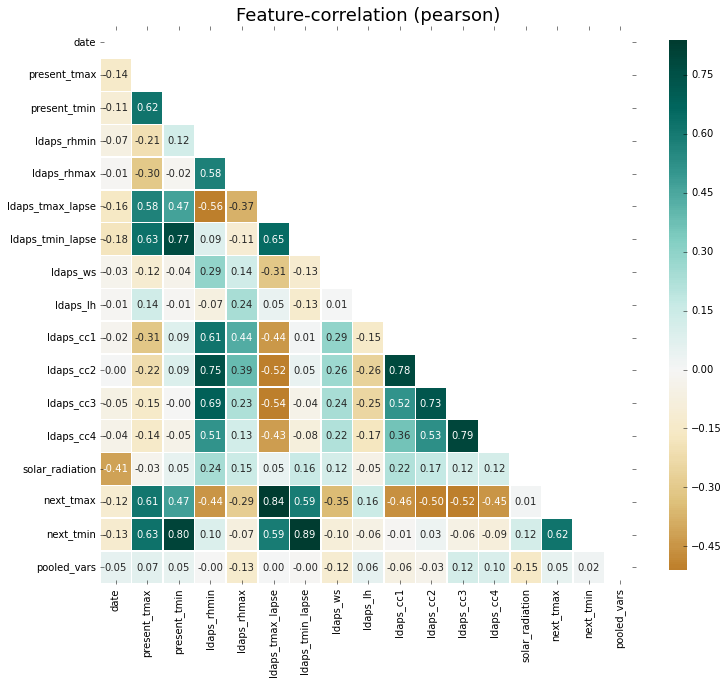

In [25]:
klib.corr_plot(Data_Day) # returns a color-encoded heatmap, ideal for correlations

GridSpec(6, 6)

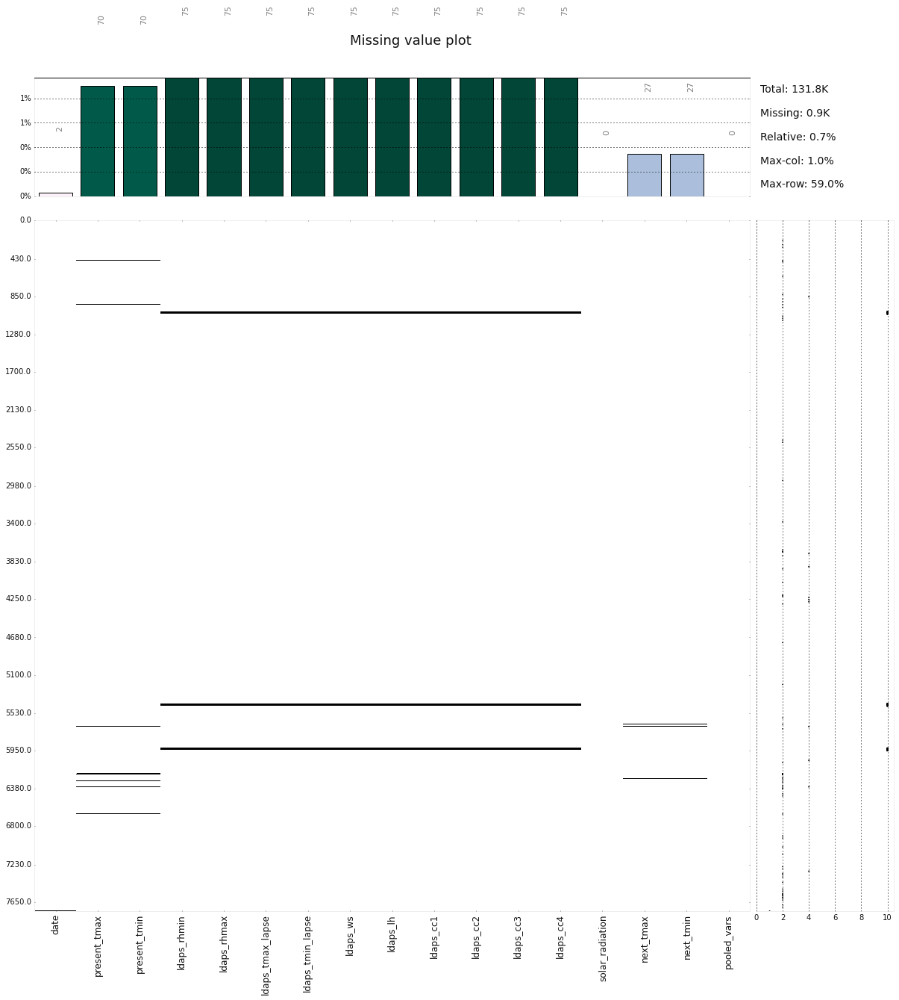

In [26]:
klib.missingval_plot(Data_Day) # returns a figure containing information about missing values

In [27]:
Data_Day.dropna(inplace = True)
Data_Day.drop_duplicates()
Data_Day

,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,ldaps_cc1,ldaps_cc2,ldaps_cc3,ldaps_cc4,solar_radiation,next_tmax,next_tmin,pooled_vars
0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,1.616969e-01,0.130928,5992.895996,29.1,21.2,0
1,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,1.594441e-01,0.127727,5869.312500,30.5,22.5,1
2,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,2.040915e-01,0.142125,5863.555664,31.1,23.9,2
3,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,1.611574e-01,0.134249,5856.964844,31.7,24.3,3
4,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,1.788925e-01,0.170021,5859.552246,31.2,22.5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,30.0,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,0.052902,0.030169,0.000000e+00,0.004380,4456.024414,27.6,17.7,7195
7746,30.0,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,0.024518,5.850000e-07,0.017678,4441.803711,28.0,17.1,6421
7747,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000e+00,0.000000,4443.313965,28.3,18.1,7197
7748,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000e+00,0.000000,4438.373535,28.6,18.8,7198


In [28]:
klib.missingval_plot(Data_Day) # returns a figure containing information about missing values

No missing values found in the dataset.


Displaying positive correlations. Specify a positive "threshold" to limit the results further.
Displaying negative correlations. Specify a negative "threshold" to limit the results further.


<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

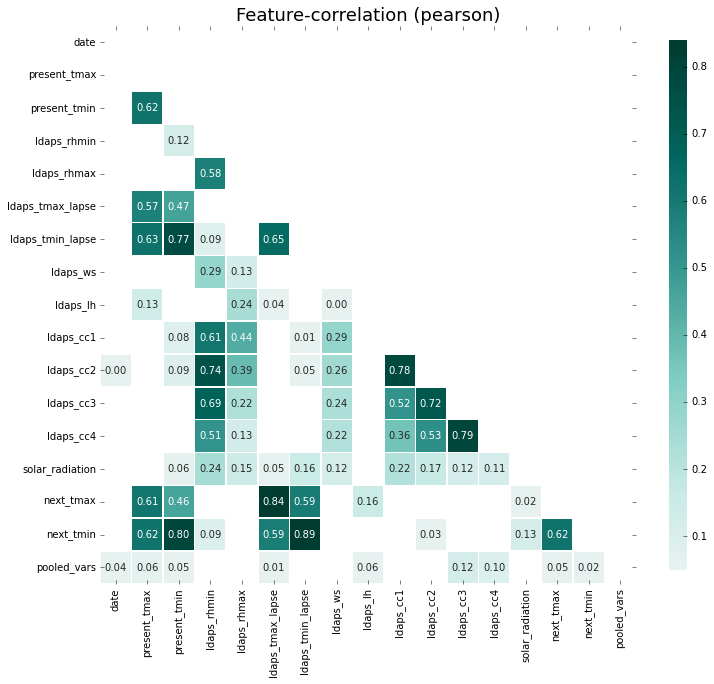

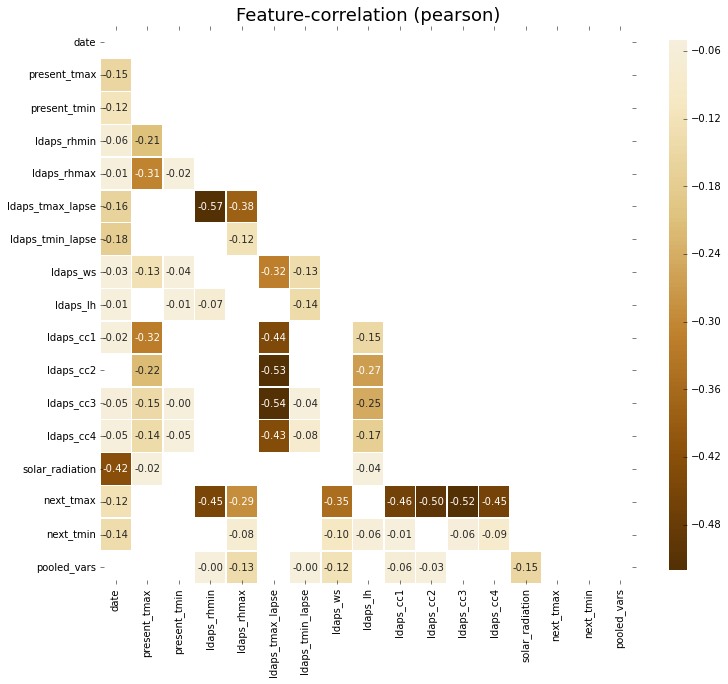

In [29]:
klib.corr_plot(Data_Day, split='pos') # displaying only positive correlations, other settings include threshold, cmap...
klib.corr_plot(Data_Day, split='neg') # displaying only negative correlations

In [30]:
#columns 
Data_Day.columns

Index(['date', 'present_tmax', 'present_tmin', 'ldaps_rhmin', 'ldaps_rhmax',
       'ldaps_tmax_lapse', 'ldaps_tmin_lapse', 'ldaps_ws', 'ldaps_lh',
       'ldaps_cc1', 'ldaps_cc2', 'ldaps_cc3', 'ldaps_cc4', 'solar_radiation',
       'next_tmax', 'next_tmin', 'pooled_vars'],
      dtype='object')

In [31]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
Note: you may need to restart the kernel to use updated packages.


In [32]:
import pandas_profiling
report = pandas_profiling.ProfileReport(Data_Day)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

                      date  present_tmax  present_tmin  ldaps_rhmin  \
date              1.000000     -0.321231     -0.377253    -0.037890   
present_tmax     -0.321231      1.000000      0.862957    -0.730690   
present_tmin     -0.377253      0.862957      1.000000    -0.421222   
ldaps_rhmin      -0.037890     -0.730690     -0.421222     1.000000   
ldaps_rhmax       0.044950     -0.769332     -0.524144     0.810432   
ldaps_tmax_lapse -0.269600      0.916180      0.775823    -0.868401   
ldaps_tmin_lapse -0.418628      0.880496      0.961590    -0.487567   
ldaps_ws          0.023319     -0.638564     -0.516437     0.643624   
ldaps_lh          0.019053      0.154532     -0.099278    -0.406100   
ldaps_cc1         0.011549     -0.773980     -0.442423     0.931487   
ldaps_cc2         0.023586     -0.724896     -0.413515     0.961366   
ldaps_cc3         0.011186     -0.697508     -0.476818     0.920409   
ldaps_cc4         0.011177     -0.678500     -0.510672     0.849103   
solar_

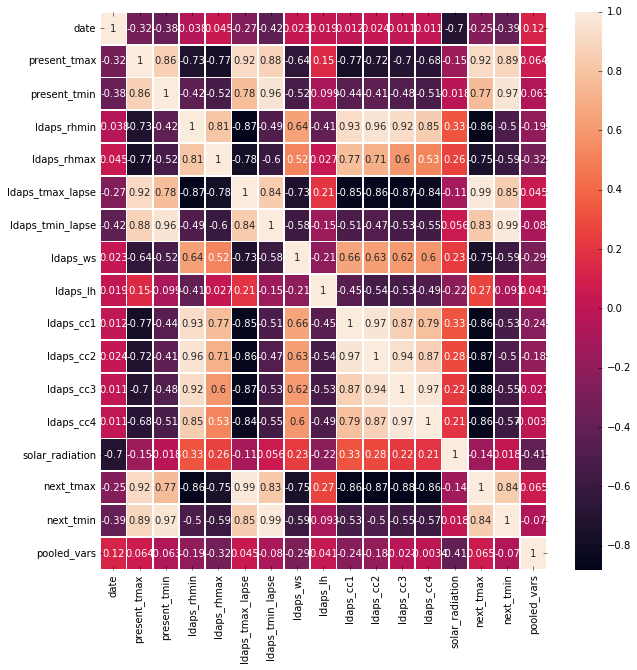

In [33]:
#Feature engineering
# Correlation Analysis and Anova test to find varaibles which can be excluded
Data_Day_cor = Data_Day.corr()
correlation_result = Data_Day_cor.corr()
print(correlation_result)
fig, ax = plt.subplots(figsize=(10,10)) ##To plot the heatmap into our required size
heatmap = sns.heatmap(correlation_result, annot=True, linewidths=.8)

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

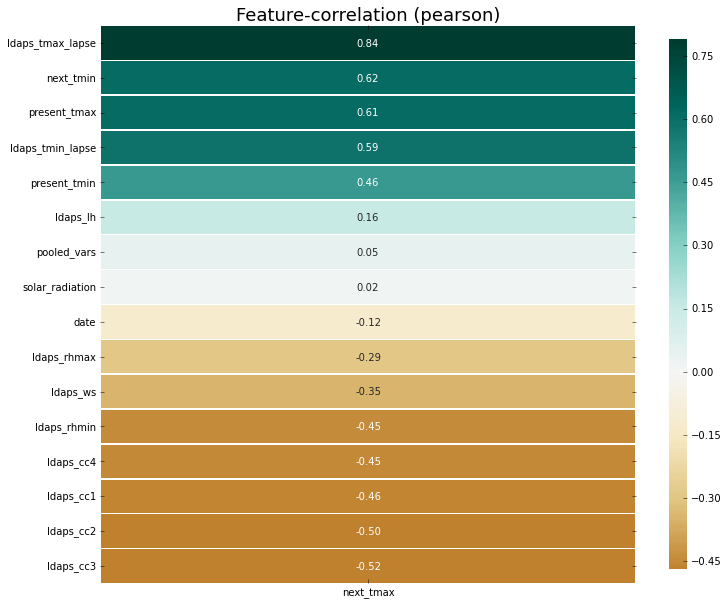

In [34]:
klib.corr_plot(Data_Day, target='next_tmax')

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

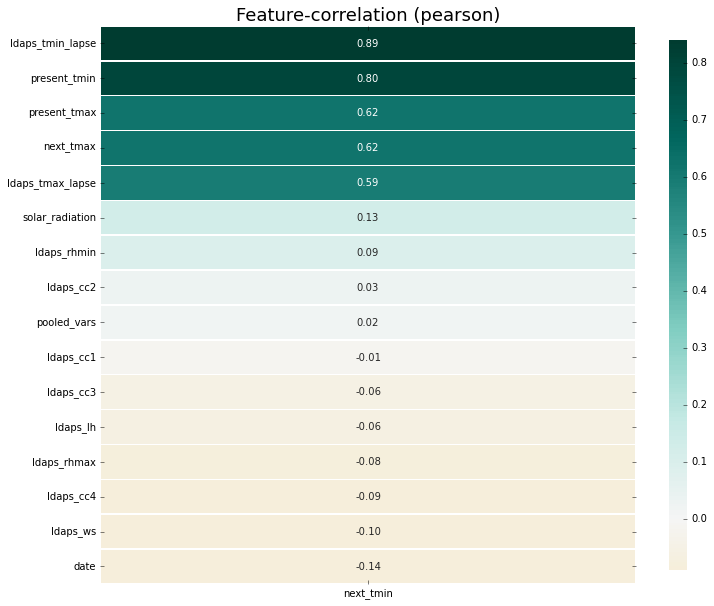

In [35]:
klib.corr_plot(Data_Day, target='next_tmin')

# DATA PRE PROCESSING

In [36]:
#sum of missing values 
Data_Day.isnull().sum()

date                0
present_tmax        0
present_tmin        0
ldaps_rhmin         0
ldaps_rhmax         0
ldaps_tmax_lapse    0
ldaps_tmin_lapse    0
ldaps_ws            0
ldaps_lh            0
ldaps_cc1           0
ldaps_cc2           0
ldaps_cc3           0
ldaps_cc4           0
solar_radiation     0
next_tmax           0
next_tmin           0
pooled_vars         0
dtype: int64

In [37]:
!pip install seaborn==0.11.0

  Using cached seaborn-0.11.0-py3-none-any.whl (283 kB)
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.11.2
    Uninstalling seaborn-0.11.2:
      Successfully uninstalled seaborn-0.11.2


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bamboolib 1.26.0 requires seaborn<0.11,>=0.10, but you have seaborn 0.11.0 which is incompatible.
klib 0.2.0 requires seaborn>=0.11.1, but you have seaborn 0.11.0 which is incompatible.


<AxesSubplot:xlabel='pooled_vars', ylabel='Density'>

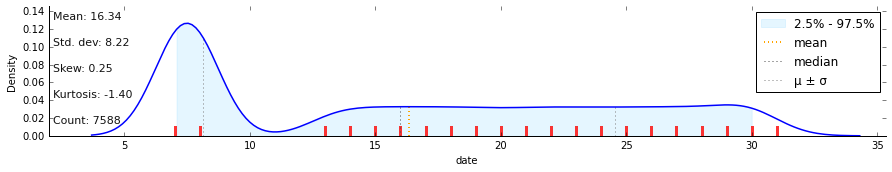

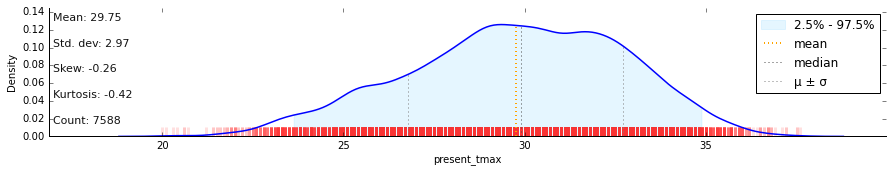

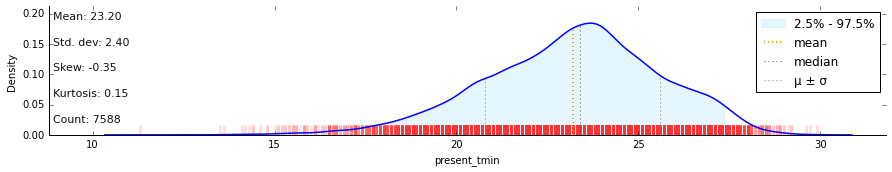

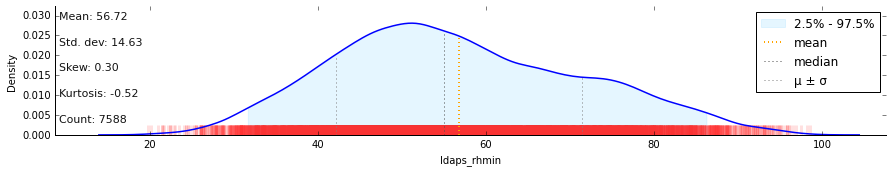

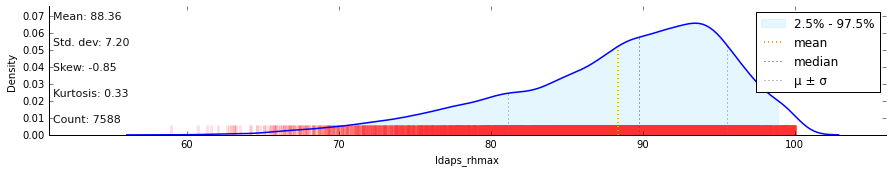

...

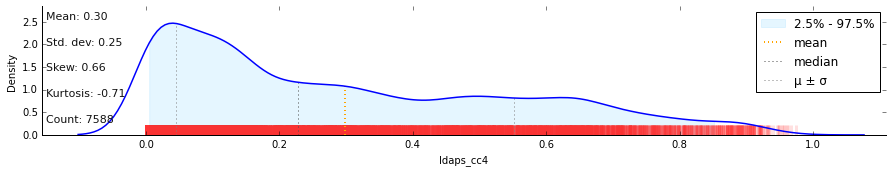

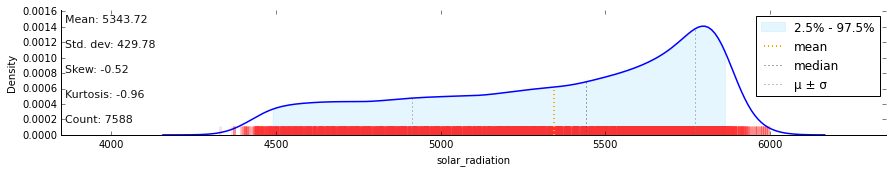

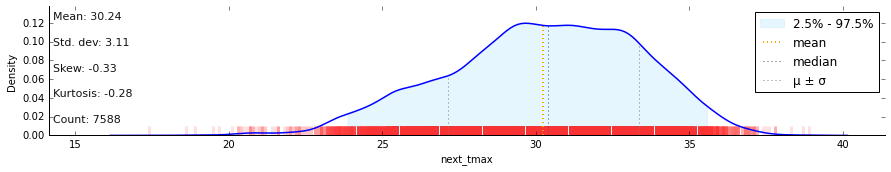

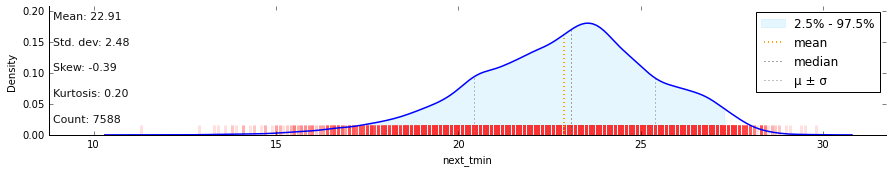

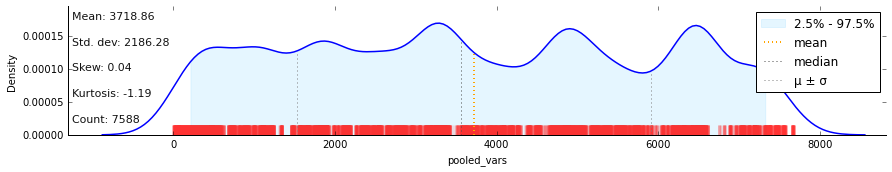

In [38]:
klib.dist_plot(Data_Day) # default representation of a distribution plot, other settings include fill_range, histogram, ...

In [39]:
#Outlier analysis

In [40]:
#columns 
Data_Day.columns

Index(['date', 'present_tmax', 'present_tmin', 'ldaps_rhmin', 'ldaps_rhmax',
       'ldaps_tmax_lapse', 'ldaps_tmin_lapse', 'ldaps_ws', 'ldaps_lh',
       'ldaps_cc1', 'ldaps_cc2', 'ldaps_cc3', 'ldaps_cc4', 'solar_radiation',
       'next_tmax', 'next_tmin', 'pooled_vars'],
      dtype='object')

In [41]:
#Defining numeric and categorical variables and saving in specific array
numeric_var = ['present_tmax', 'ldaps_rhmin', 'ldaps_rhmax', 'ldaps_tmax_lapse',
       'ldaps_tmin_lapse', 'ldaps_ws', 'ldaps_lh', 'ldaps_cc1', 'ldaps_cc2',
       'ldaps_cc3', 'ldaps_cc4', 'solar_radiation', 'next_tmax', 'next_tmin',
       'pooled_vars_y']

In [42]:
Q1 = Data_Day.quantile(0.25)
Q3 = Data_Day.quantile(0.75)
IQR=Q3-Q1
lowqe_bound=Q1 - 1.5 * IQR
upper_bound=Q3 + 1.5 * IQR
print(lowqe_bound,upper_bound)

date                 -16.000000
present_tmax          21.500000
present_tmin          16.800000
ldaps_rhmin           14.227960
ldaps_rhmax           69.895222
ldaps_tmax_lapse      21.617726
ldaps_tmin_lapse      17.483560
ldaps_ws               2.144954
ldaps_lh             -33.337996
ldaps_cc1             -0.494894
ldaps_cc2             -0.484935
ldaps_cc3             -0.492292
ldaps_cc4             -0.543452
solar_radiation     3909.485534
next_tmax             21.600000
next_tmin             16.350000
pooled_vars        -3631.875000
dtype: float64 date                   48.000000
present_tmax           38.300000
present_tmin           29.600000
ldaps_rhmin            98.847383
ldaps_rhmax           108.051228
ldaps_tmax_lapse       37.767140
ldaps_tmin_lapse       29.758920
ldaps_ws               11.559364
ldaps_lh              154.779863
ldaps_cc1               1.215614
ldaps_cc2               1.182423
ldaps_cc3               1.089686
ldaps_cc4               1.123074
solar_radiat

present_tmax


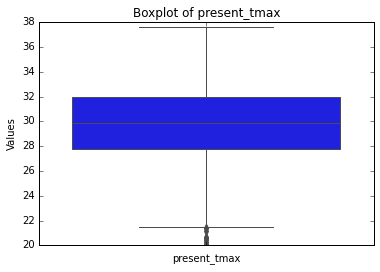

ldaps_rhmin


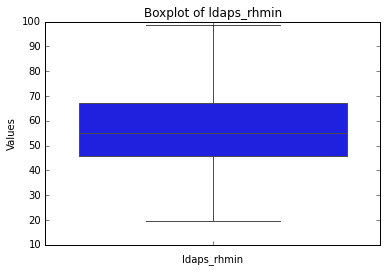

ldaps_rhmax


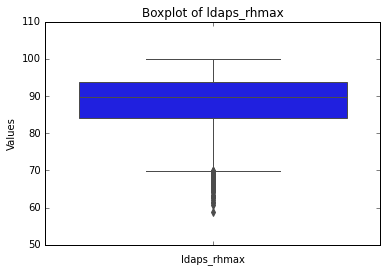

ldaps_tmax_lapse


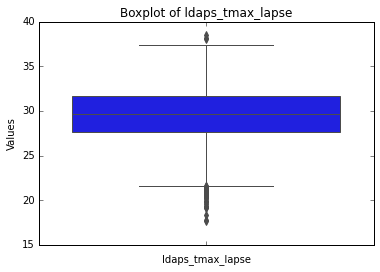

ldaps_tmin_lapse


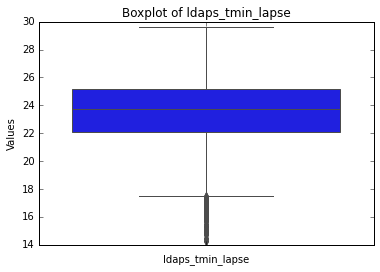

ldaps_ws


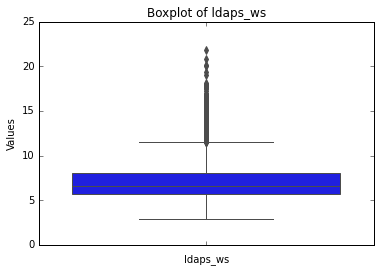

ldaps_lh


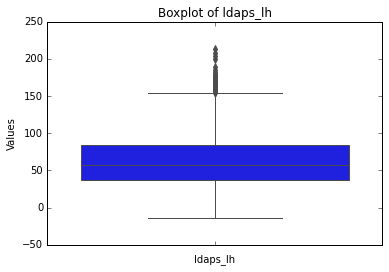

ldaps_cc1


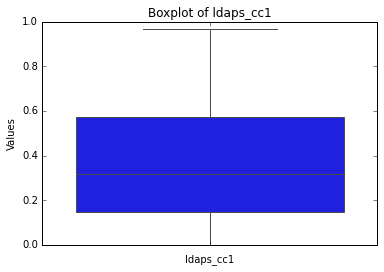

ldaps_cc2


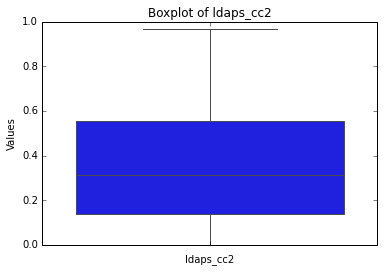

ldaps_cc3


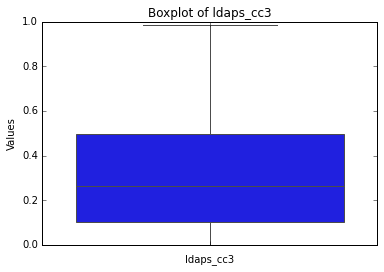

ldaps_cc4


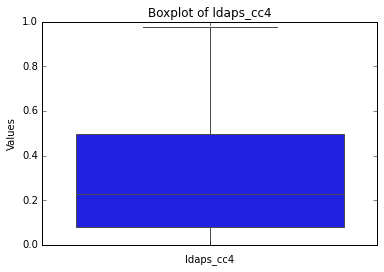

solar_radiation


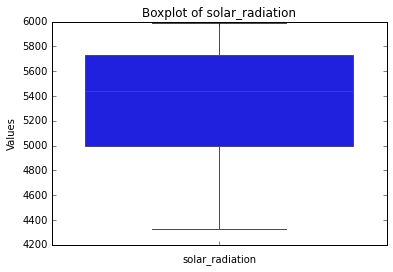

next_tmax


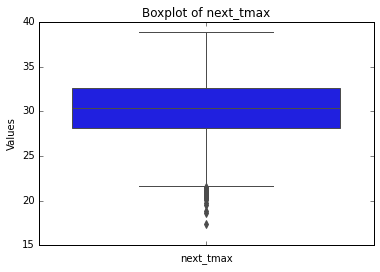

next_tmin


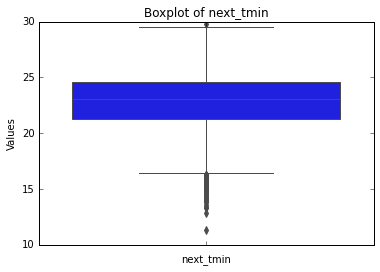

pooled_vars_y


KeyError: 'pooled_vars_y'

In [43]:
import matplotlib.pyplot as plt
plt.style.use('classic')
%matplotlib inline

for i in numeric_var:
    print(i)
    sns.boxplot(y = Data_Day[i])
    plt.xlabel(i)
    plt.ylabel("Values")
    plt.title("Boxplot of " + i)
    plt.show()

In [44]:
IQR_price = Data_Day[~((Data_Day < lowqe_bound) |(Data_Day > upper_bound)).any(axis=1)]
Data_Day = IQR_price
Data_Day

,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,ldaps_cc1,ldaps_cc2,ldaps_cc3,ldaps_cc4,solar_radiation,next_tmax,next_tmin,pooled_vars
0,30.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,1.616969e-01,0.130928,5992.895996,29.1,21.2,0
1,30.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,1.594441e-01,0.127727,5869.312500,30.5,22.5,1
2,30.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,2.040915e-01,0.142125,5863.555664,31.1,23.9,2
3,30.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,1.611574e-01,0.134249,5856.964844,31.7,24.3,3
4,30.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,1.788925e-01,0.170021,5859.552246,31.2,22.5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,30.0,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,0.052902,0.030169,0.000000e+00,0.004380,4456.024414,27.6,17.7,7195
7746,30.0,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,0.024518,5.850000e-07,0.017678,4441.803711,28.0,17.1,6421
7747,30.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000e+00,0.000000,4443.313965,28.3,18.1,7197
7748,30.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000e+00,0.000000,4438.373535,28.6,18.8,7198


***We are getting some outliers in the above graphs.***

present_tmax


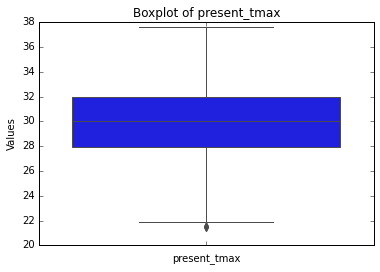

ldaps_rhmin


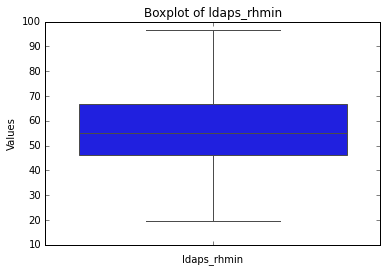

ldaps_rhmax


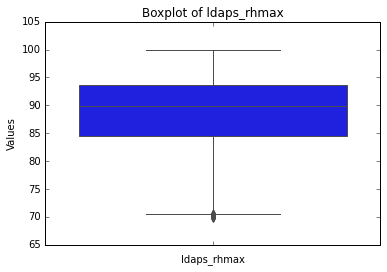

ldaps_tmax_lapse


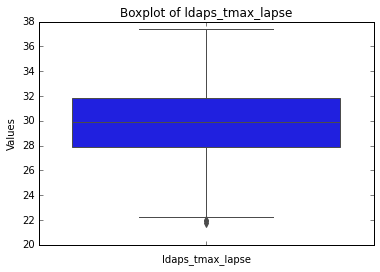

ldaps_tmin_lapse


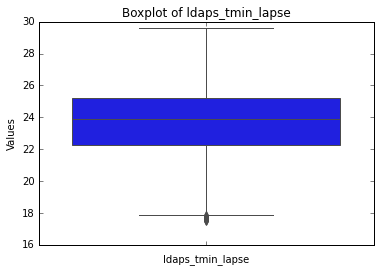

ldaps_ws


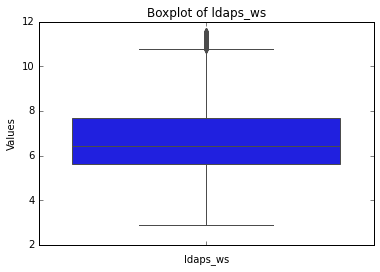

ldaps_lh


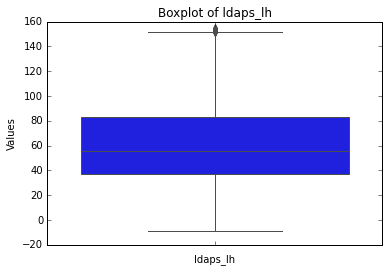

ldaps_cc1


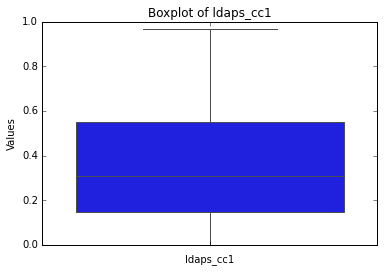

ldaps_cc2


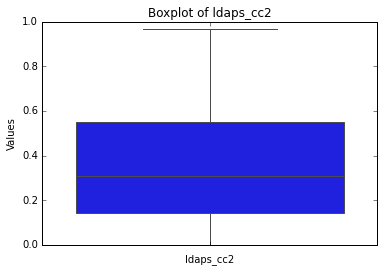

ldaps_cc3


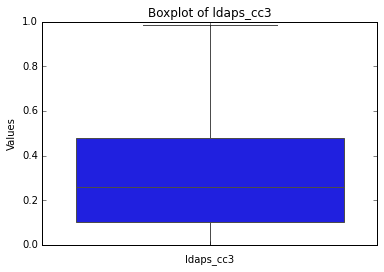

ldaps_cc4


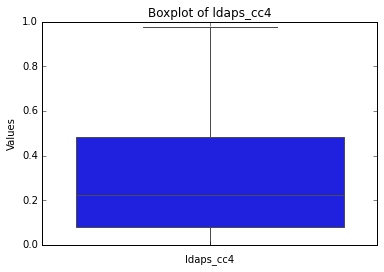

solar_radiation


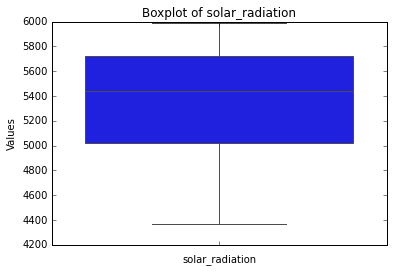

next_tmax


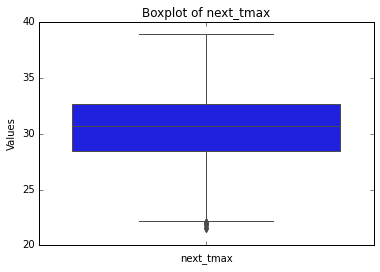

next_tmin


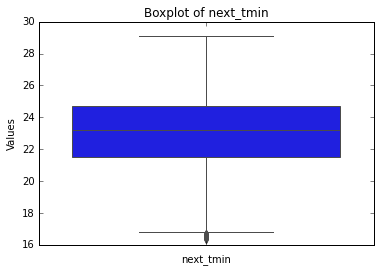

pooled_vars_y


KeyError: 'pooled_vars_y'

In [45]:
###Checking null values again
for i in numeric_var:
    print(i)
    sns.boxplot(y = Data_Day[i])
    plt.xlabel(i)
    plt.ylabel("Values")
    plt.title("Boxplot of " + i)
    plt.show()

Still there are some outliers in the dataset as we tried imputinng the datawith 

In [46]:
Data_Day.describe()

,date,present_tmax,present_tmin,ldaps_rhmin,ldaps_rhmax,ldaps_tmax_lapse,ldaps_tmin_lapse,ldaps_ws,ldaps_lh,ldaps_cc1,ldaps_cc2,ldaps_cc3,ldaps_cc4,solar_radiation,next_tmax,next_tmin,pooled_vars
count,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000,6909.000000
mean,16.210884,29.851180,23.346780,56.665856,88.627959,29.837430,23.716680,6.753311,61.245969,0.363540,0.352649,0.310193,0.291499,5351.353921,30.483398,23.114315,3698.636561
std,8.142191,2.871939,2.244891,14.171325,6.628353,2.770962,2.120114,1.621458,32.102722,0.260450,0.254820,0.242414,0.248372,415.020561,2.955331,2.277157,2177.340419
min,7.000000,21.500000,16.900000,19.794666,69.898956,21.739494,17.517775,2.882580,-8.569043,0.000000,0.000000,0.000000,0.000000,4371.684570,21.600000,16.400000,0.000000
25%,8.000000,27.900000,21.800000,46.339367,84.463669,27.913488,22.275341,5.618257,37.163316,0.146654,0.141700,0.102495,0.080452,5019.580078,28.500000,21.500000,1848.000000
50%,16.000000,30.000000,23.400000,55.059258,89.804489,29.895099,23.867667,6.445847,56.063670,0.308562,0.309052,0.258542,0.222532,5438.388672,30.700000,23.200000,3586.000000
75%,23.000000,32.000000,24.900000,66.704163,93.727539,31.813651,25.221275,7.682873,82.906014,0.552626,0.552315,0.480810,0.481586,5723.705566,32.700000,24.700000,5515.000000
max,31.000000,37.600000,29.200000,96.564728,100.000153,37.438654,29.619342,11.558632,154.567392,0.967277,0.965889,0.983757,0.974710,5992.895996,38.900000,29.100000,7674.000000


***Here we can eaisly infer that almost every variable is distribute  allmost normely in bell curve, except total bags. Also, Year has come twice.

In [47]:
!pip install pycaret[Full]==2.3. 4

In [48]:
from pycaret.regression import *

Missing value during model deployment may produce errors during execution

In [49]:
s = setup(Data_Day, target = 'next_tmax')
best_model1 = compare_models()
tuned_model1 = tune_model(best_model1)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.7453,0.9141,0.9561,0.8899,0.0309,0.0247
1,0.7529,0.8833,0.9398,0.8958,0.0304,0.0250
2,0.7108,0.8697,0.9326,0.8984,0.0306,0.0238
3,0.6942,0.8325,0.9124,0.8999,0.0293,0.0230
4,0.7012,0.8537,0.9239,0.9007,0.0300,0.0233
5,0.6798,0.7450,0.8631,0.9122,0.0281,0.0227
6,0.7337,0.8801,0.9382,0.9063,0.0300,0.0242
7,0.6850,0.8446,0.9190,0.9005,0.0297,0.0228
8,0.7398,0.9476,0.9734,0.8982,0.0317,0.0247
9,0.7244,0.8520,0.9230,0.9039,0.0304,0.0244


In [50]:
evaluate_model(tuned_model1)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [51]:
# create copy of data drop target column
Data1 = Data_Day.copy()
# generate predictions
predictions1 = predict_model(best_model1, data = Data1)
Res1 = predictions1['Label']
Res1

0       29.353502
1       31.216883
2       31.274788
3       31.787249
4       31.104969
          ...    
7745    27.878141
7746    27.789924
7747    28.288333
7748    28.345682
7749    27.616687
Name: Label, Length: 6909, dtype: float64

In [52]:
setup(Data_Day, target = 'next_tmin')
best_model2 = compare_models()
tuned_model2 = tune_model(best_model2)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.4839,0.4200,0.6480,0.9216,0.0281,0.0215
1,0.5024,0.4419,0.6647,0.9106,0.0289,0.0223
2,0.4768,0.3913,0.6256,0.9161,0.0269,0.0210
3,0.4999,0.4058,0.6370,0.9185,0.0268,0.0218
4,0.4967,0.4218,0.6495,0.9244,0.0279,0.0219
5,0.5042,0.4286,0.6547,0.9123,0.0278,0.0222
6,0.4975,0.4117,0.6416,0.9183,0.0274,0.0220
7,0.5191,0.4563,0.6755,0.9171,0.0296,0.0233
8,0.5244,0.4642,0.6814,0.9106,0.0297,0.0234
9,0.5113,0.4408,0.6639,0.9147,0.0286,0.0227


In [53]:
# generate predictions
# create copy of data drop target column
Data2 = Data_Day.copy()
# generate predictions
predictions2 = predict_model(best_model2, data = Data2)
Res2 = predictions2['Label']
Res2

0       21.406158
1       22.287405
2       23.678901
3       23.204370
4       22.371373
          ...    
7745    17.706841
7746    17.155513
7747    17.359432
7748    18.353458
7749    17.510252
Name: Label, Length: 6909, dtype: float64

In [54]:
prediction  = [Res1, Res2]
prediction

[0       29.353502
 1       31.216883
 2       31.274788
 3       31.787249
 4       31.104969
           ...    
 7745    27.878141
 7746    27.789924
 7747    28.288333
 7748    28.345682
 7749    27.616687
 Name: Label, Length: 6909, dtype: float64,
 0       21.406158
 1       22.287405
 2       23.678901
 3       23.204370
 4       22.371373
           ...    
 7745    17.706841
 7746    17.155513
 7747    17.359432
 7748    18.353458
 7749    17.510252
 Name: Label, Length: 6909, dtype: float64]

In [60]:
evaluate_model(tuned_model2)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…